In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install dlutils
!pip install yacs

In [ ]:
import glob
import matplotlib.pyplot as plt
import cv2
from tqdm import tqdm
import numpy as np


dir_ls = sorted(glob.glob("drive/MyDrive/label_rotated/plot_level_image/*"))
print(dir_ls)
figures = []
for dir in dir_ls[1:]:
  for png in tqdm(sorted(glob.glob(dir + '/*.png'))):
    figures.append(cv2.resize(plt.imread(png), (128, 128)))
figs = np.array(figures)

['drive/MyDrive/label_rotated/plot_level_image/06292020', 'drive/MyDrive/label_rotated/plot_level_image/07092020', 'drive/MyDrive/label_rotated/plot_level_image/07152020', 'drive/MyDrive/label_rotated/plot_level_image/07182020', 'drive/MyDrive/label_rotated/plot_level_image/07222020', 'drive/MyDrive/label_rotated/plot_level_image/07282020', 'drive/MyDrive/label_rotated/plot_level_image/08012020', 'drive/MyDrive/label_rotated/plot_level_image/08202020', 'drive/MyDrive/label_rotated/plot_level_image/08262020', 'drive/MyDrive/label_rotated/plot_level_image/09092020', 'drive/MyDrive/label_rotated/plot_level_image/09182020', 'drive/MyDrive/label_rotated/plot_level_image/10022020']


100%|██████████| 500/500 [00:01<00:00, 299.15it/s]


In [ ]:
for i in tqdm(range(figs.shape[0])):
  figs[i] = (figs[i] - np.mean(figs[i]))/np.std(figs[i])
  # figs[i][figs[i]<0]=0
  
  # figs[i] -= np.min(figs[i])
  # figs[i] /= np.max(figs[i])

100%|██████████| 5500/5500 [00:01<00:00, 3840.89it/s]


In [ ]:
figs.shape

(5500, 128, 128)

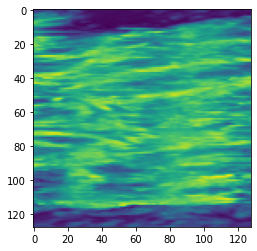

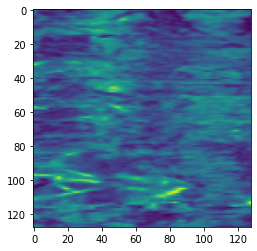

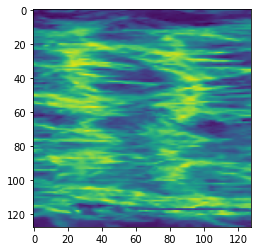

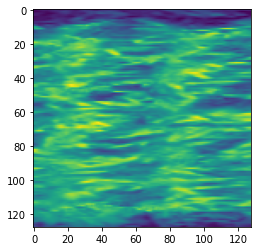

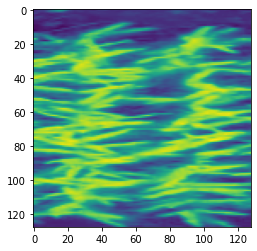

...

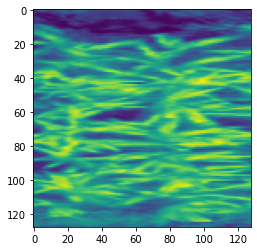

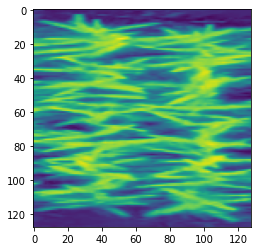

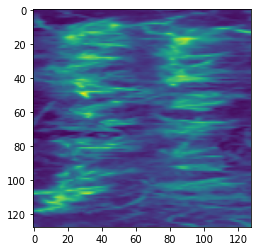

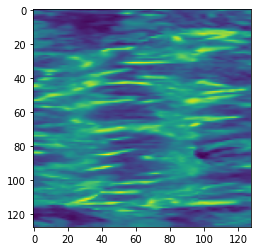

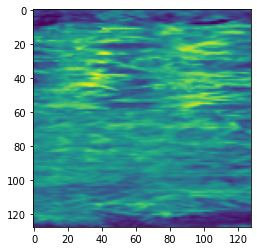

In [ ]:
figs.shape
shuffled = np.random.shuffle(figs)
for i in figs[:20]:
  plt.imshow(i)
  plt.show()

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F


class VAE(nn.Module):
    def __init__(self, zsize, layer_count=3, channels=1):
        super(VAE, self).__init__()

        d = 128
        self.d = d
        self.zsize = zsize

        self.layer_count = layer_count

        mul = 1
        inputs = channels
        for i in range(self.layer_count):
            setattr(self, "conv%d" % (i + 1), nn.Conv2d(inputs, d * mul, 4, 2, 1))
            setattr(self, "conv%d_bn" % (i + 1), nn.BatchNorm2d(d * mul))
            inputs = d * mul
            mul *= 2
        
        self.d_min = d // mul
        self.d_max = inputs

        self.fc1 = nn.Linear(inputs * self.d_min * self.d_min, zsize)
        self.fc2 = nn.Linear(inputs * self.d_min * self.d_min, zsize)

        self.d1 = nn.Linear(zsize, inputs * self.d_min * self.d_min)

        mul = inputs // d // 2

        for i in range(1, self.layer_count):
            setattr(self, "deconv%d" % (i + 1), nn.ConvTranspose2d(inputs, d * mul, 4, 2, 1))
            setattr(self, "deconv%d_bn" % (i + 1), nn.BatchNorm2d(d * mul))
            inputs = d * mul
            mul //= 2

        setattr(self, "deconv%d" % (self.layer_count + 1), nn.ConvTranspose2d(inputs, channels, 4, 2, 1))

    def encode(self, x):
        for i in range(self.layer_count):
            x = F.relu(getattr(self, "conv%d_bn" % (i + 1))(getattr(self, "conv%d" % (i + 1))(x)))
        
        x = x.view(x.shape[0], self.d_max * self.d_min * self.d_min)
        h1 = self.fc1(x)
        h2 = self.fc2(x)
        return h1, h2

    def reparameterize(self, mu, logvar):
        if self.training:
            std = torch.exp(0.5 * logvar)
            eps = torch.randn_like(std)
            return eps.mul(std).add_(mu)
        else:
            return mu

    def decode(self, x):
        x = x.view(x.shape[0], self.zsize)
        x = self.d1(x)
        x = x.view(x.shape[0], self.d_max, self.d_min, self.d_min)
        #x = self.deconv1_bn(x)
        x = F.leaky_relu(x, 0.2)


        for i in range(1, self.layer_count):
            x = F.leaky_relu(getattr(self, "deconv%d_bn" % (i + 1))(getattr(self, "deconv%d" % (i + 1))(x)), 0.2)

        x = F.tanh(getattr(self, "deconv%d" % (self.layer_count + 1))(x))
        return x

    def forward(self, x):
        mu, logvar = self.encode(x)
        mu = mu.squeeze()
        logvar = logvar.squeeze()
        z = self.reparameterize(mu, logvar)
        return self.decode(z.view(-1, self.zsize, 1, 1)), mu, logvar

    def weight_init(self, mean, std):
        for m in self._modules:
            normal_init(self._modules[m], mean, std)


def normal_init(m, mean, std):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        m.weight.data.normal_(mean, std)
        m.bias.data.zero_()

In [ ]:
device = torch.cuda.current_device()
torch.set_default_tensor_type('torch.cuda.FloatTensor')
DoubleTensor = torch.cuda.DoubleTensor
FloatTensor = torch.cuda.FloatTensor
HalfTensor = torch.cuda.HalfTensor
LongTensor = torch.cuda.LongTensor
IntTensor = torch.cuda.IntTensor
ShortTensor = torch.cuda.ShortTensor
CharTensor = torch.cuda.CharTensor
ByteTensor = torch.cuda.ByteTensor

In [ ]:
from __future__ import print_function
import torch.utils.data
from scipy import misc
from torch import optim
from torchvision.utils import save_image
import numpy as np
import pickle
import time
import random
import copy
import os
from PIL import Image
from dlutils import batch_provider

im_size = 128


def loss_function(recon_x, x, mu, logvar):
    BCE = torch.mean((recon_x - x)**2)

    # see Appendix B from VAE paper:
    # Kingma and Welling. Auto-Encoding Variational Bayes. ICLR, 2014
    # https://arxiv.org/abs/1312.6114
    # 0.5 * sum(1 + log(sigma^2) - mu^2 - sigma^2)
    KLD = -0.5 * torch.mean(torch.mean(1 + logvar - mu.pow(2) - logvar.exp(), 1))
    return BCE, KLD * 0.00001


def process_batch(batch):
    # data = [misc.imresize(x, [im_size, im_size]).transpose((2, 0, 1)) for x in batch]
    # print(batch.shape)
    # data = [np.array(Image.fromarray(x).resize([im_size, im_size]))# .transpose((2, 0, 1))
    #         for x in batch]
    x = torch.from_numpy(np.asarray(batch, dtype=np.float32)).cuda() # / 127.5 - 1.
    x = x.view(-1, 1, im_size, im_size)
    return x


def main():
    batch_size = 128
    z_size = 512
    vae = VAE(zsize=z_size, layer_count=6)
    vae.cuda()
    vae.train()
    vae.weight_init(mean=0, std=0.02)

    lr = 0.001
    

    vae_optimizer = optim.Adam(vae.parameters(), lr=lr, betas=(0.9, 0.999), weight_decay=1e-5)
 
    train_epoch = 100

    sample1 = torch.randn(128, z_size).view(-1, z_size, 1, 1)
    
    dt = copy.deepcopy(figs)

    for epoch in range(train_epoch):
        vae.train()

        # with open('data_fold_%d.pkl' % (epoch % 5), 'rb') as pkl:
        #     data_train = pickle.load(pkl)
        s = epoch % 5 * (1100)
        e = (epoch % 5 + 1) * (1100)
        data_train = copy.deepcopy(dt[s:e])
        np.random.shuffle(data_train)

        print("Train set size:", len(data_train))

        # random.shuffle(data_train)

        batches = batch_provider(data_train, batch_size, process_batch, report_progress=True)

        rec_loss = 0
        kl_loss = 0

        epoch_start_time = time.time()

        if (epoch + 1) % 8 == 0:
            vae_optimizer.param_groups[0]['lr'] /= 4
            print("learning rate change!")

        i = 0
        for x in batches:
            vae.train()
            vae.zero_grad()
            rec, mu, logvar = vae(x)

            loss_re, loss_kl = loss_function(rec, x, mu, logvar)
            (loss_re + loss_kl).backward()
            vae_optimizer.step()
            rec_loss += loss_re.item()
            kl_loss += loss_kl.item()

            #############################################

            os.makedirs('results_rec', exist_ok=True)
            os.makedirs('results_gen', exist_ok=True)

            epoch_end_time = time.time()
            per_epoch_ptime = epoch_end_time - epoch_start_time

            # report losses and save samples each 60 iterations
            m = 18
            i += 1
            if i % m == 0:
                rec_loss /= m
                kl_loss /= m
                print('\n[%d/%d] - ptime: %.2f, rec loss: %.9f, KL loss: %.9f' % (
                    (epoch + 1), train_epoch, per_epoch_ptime, rec_loss, kl_loss))
                rec_loss = 0
                kl_loss = 0
                with torch.no_grad():
                    vae.eval()
                    x_rec, _, _ = vae(x)
                    resultsample = torch.cat([x, x_rec]) * 0.5 + 0.5
                    resultsample = resultsample.cpu()
                    save_image(resultsample.view(-1, 1, im_size, im_size),
                               'results_rec/sample_' + str(epoch) + "_" + str(i) + '.png')
                    x_rec = vae.decode(sample1)
                    resultsample = x_rec * 0.5 + 0.5
                    resultsample = resultsample.cpu()
                    save_image(resultsample.view(-1, 1, im_size, im_size),
                               'results_gen/sample_' + str(epoch) + "_" + str(i) + '.png')

        del batches
        del data_train
    print("Training finish!... save training results")
    torch.save(vae.state_dict(), "VAEmodel.pkl")

if __name__ == '__main__':
    main()

RuntimeError: ignored

In [ ]:
PATH = 'drive/MyDrive/label_rotated/VAEmodel.pkl'
z_size = 512
vae = VAE(zsize=z_size, layer_count=5)
#vae.load_state_dict(torch.load(PATH))
vae.eval()

VAE(
  (conv1): Conv2d(1, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv1_bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3_bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv4_bn): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(1024, 2048, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv5_bn): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=32768, out_features=512, bias=True)
  (fc2): Linear(in_features=32768, out_features=512, bias=

Progress: |#--------------------------------------------------| 2.3% [1/43] /usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:1795: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


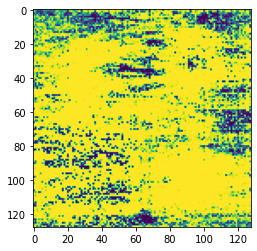

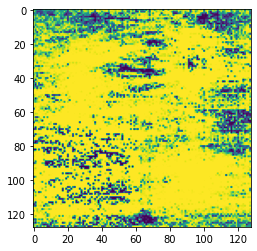

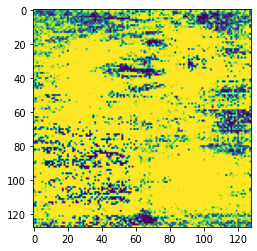

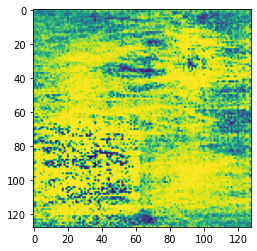

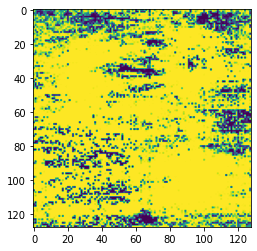

...

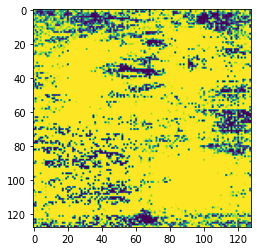

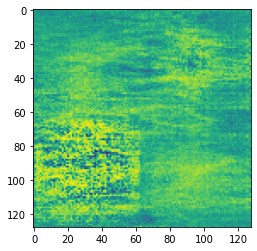

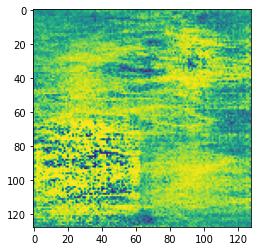

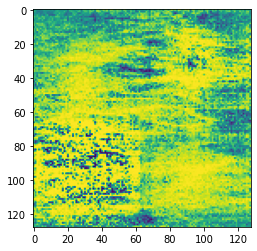

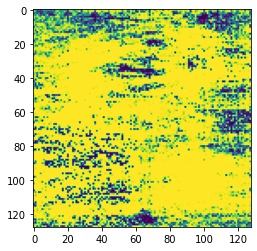

Progress: |##-------------------------------------------------| 4.7% [2/43] 

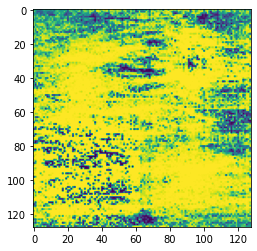

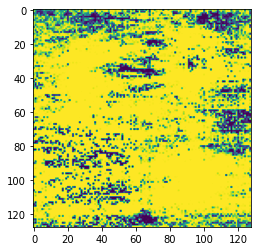

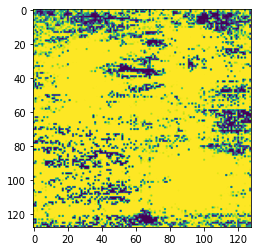

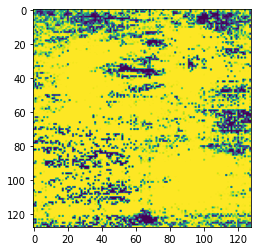

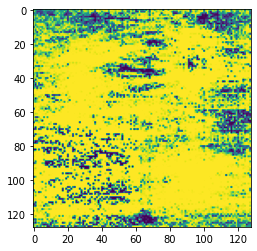

...

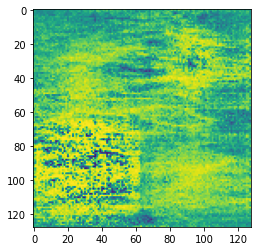

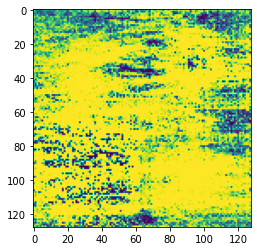

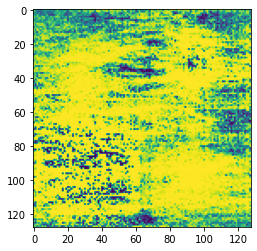

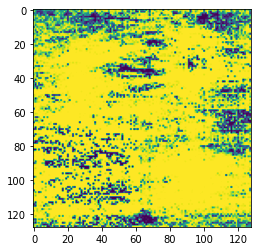

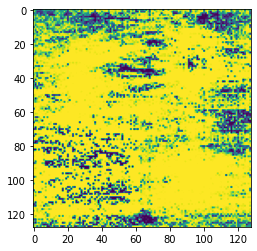

Progress: |###------------------------------------------------| 7.0% [3/43] 

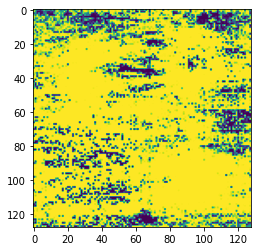

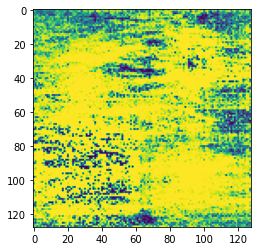

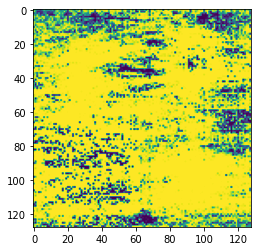

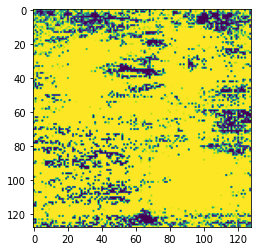

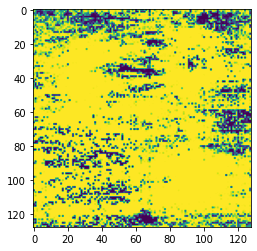

...

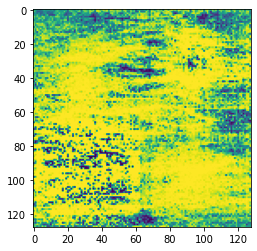

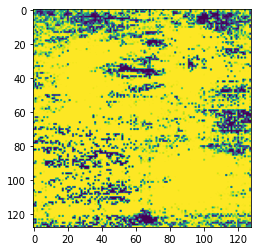

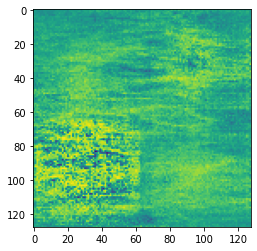

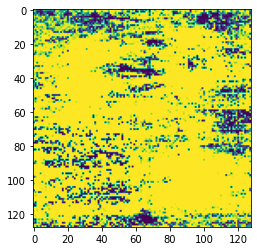

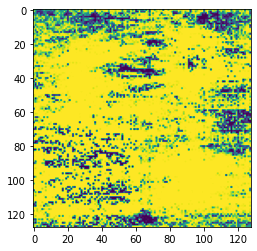

KeyboardInterrupt: ignored

In [ ]:
plt.imshow(figs[1])
batches = batch_provider(figs, 1, process_batch, report_progress=True)
for x in batches:
  x_rec, _, _ = vae(x)
  print(x_rec.shape)
  x_rec = torch.squeeze(x_rec)
  print(x_rec.shape)
  # for i in range(1):
  #   plt.imshow(x_rec[i].cpu().detach().numpy())
  #   plt.show()